In [174]:
import pandas as pd
import networkx as nx # for later
from matplotlib import pyplot as plt
from matplotlib import pylab
%matplotlib inline

In [175]:
#Read original data
file_path = 'crimes_with_residences2.csv'
#needs to specify that the block group codes needs to be read as string 
crime = pd.read_csv(file_path, dtype = {'blockgroup_residence' : str,
                                        'blockgroup' : str })
##eliminates the last digit to go from block to tract; you can skip this step if wanted more resolution on crime data
crime['tract_residence'] = crime.blockgroup_residence.str[:-1] #adding two more columns
crime['tract_crime'] = crime.blockgroup.str[:-1] 

In [176]:
crime

,Unnamed: 0,X,CaseID,CaseNumber,Location,ReportedDate,OccurredFromDate,OccurredThroughDate,OffenseID,IBRCode,...,Race,Ethnicity,GangAffiliation,YearOfBirth,CurrentAge,lat_residence,lon_residence,blockgroup_residence,tract_residence,tract_crime
0,1,154,673371,2010-00118035,50 EATON ST,11/6/10 1:09,11/6/10 1:09,11/6/10 1:09,587077,90Z,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44007002300
1,2,155,673371,2010-00118035,50 EATON ST,11/6/10 1:09,11/6/10 1:09,11/6/10 1:09,576015,120,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44007002300
2,3,156,623467,2009-00035148,50 EATON ST,4/8/09 20:02,4/8/09 20:02,4/8/09 20:02,519446,23H,...,White,NonHispanic,Plain Street Group,1989.0,27.0,41.813327,-71.416567,440070007002,44007000700,44007002300
3,4,157,608066,2008-00116479,50 EATON ST,10/7/08 17:37,10/3/08 12:00,10/7/08 17:30,501469,250,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44007002300
4,5,158,754943,2013-00084097,255 ATWELLS AVE,9/4/13 17:19,9/4/13 13:30,9/4/13 13:30,667426,23F,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44007000900
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189947,189948,191562,831568,2016-00047939,66 BORINQUEN ST,5/24/16 6:24,5/24/16 6:24,5/24/16 6:24,748549,90C,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44007000600
189948,189949,191563,831568,2016-00047939,66 BORINQUEN ST,5/24/16 6:24,5/24/16 6:24,5/24/16 6:24,748550,13B,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44007000600
189949,189950,191564,831568,2016-00047939,66 BORINQUEN ST,5/24/16 6:24,5/24/16 6:24,5/24/16 6:24,748551,13B,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44007000600
189950,189951,191565,831568,2016-00047939,66 BORINQUEN ST,5/24/16 6:24,5/24/16 6:24,5/24/16 6:24,748552,90Z,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44007000600


In [177]:
#Using pandas to generate the edge_list
crime_edge_list = crime.groupby(['tract_residence', 'tract_crime']).CaseID.count()

In [178]:
crime_edge_list.tail()

tract_residence  tract_crime
44007016300      44007000800    2
                 44007002500    5
                 44007003100    2
                 44007003200    1
                 44007003500    1
Name: CaseID, dtype: int64

Note: try to understand the steps until here to be able to resuse the codes to create edge list from tables

In [179]:
#this step is to add a colum as index and keep the first two as table indexes.
crime_edge_list = crime_edge_list.reset_index(level=['tract_residence', 'tract_crime'])
crime_edge_list.head()

,tract_residence,tract_crime,CaseID
0,44007000101,44007000101,225
1,44007000101,44007000102,47
2,44007000101,44007000200,16
3,44007000101,44007000300,40
4,44007000101,44007000400,18


In [180]:
file_path = 'flows.csv' #change here is necessary

flows = pd.read_csv(file_path, dtype = {'o' : str,
                                        'd' : str })

commuting_edge_list = flows.groupby(['o', 'd']).flow.sum()
commuting_edge_list = commuting_edge_list.reset_index(level=['o', 'd'])


In [181]:
commuting_edge_list.head()

,o,d,flow
0,01117030330,44005040900,10
1,04013216846,44007003602,10
2,04013319201,44005040200,15
3,04013610400,44003021800,10
4,06001422300,44007003602,15


In [222]:
coords = pd.read_csv('tract_coords.csv', dtype = {'GEOID' : str})

In [223]:
coords.head()

,GEOID,lon,lat
0,44007013101,-71.733651,41.893439
1,44007013102,-71.626832,41.893404
2,44007018100,-71.503966,42.014082
3,44007018200,-71.495841,42.010987
4,44007016300,-71.410744,41.865653


In [227]:
nod_w_coord = coords['GEOID']

In [228]:
len(nod_w_coord)

141

In [229]:
len(commuting_edge_list)

19216

In [230]:
len(crime_edge_list)

1479

This network has 141 census tracks and 19,216 commuting links 1,479 police offenses links

In [245]:
def prep_G(G,nod_w_coord):
    G_sub = G.copy()
    for n in G.nodes():
        #print(n)
        #list(nod_w_coord)
        if str(n) not in list(nod_w_coord):
            G_sub.remove_node(n) 
    return G_sub

In [446]:
crime_nx = nx.DiGraph()    #directed graph
for i in range(len(crime_edge_list)):
    crime_nx.add_edge(crime_edge_list.tract_residence[i],
               crime_edge_list.tract_crime[i],
               weight=crime_edge_list.CaseID[i]) 

In [447]:
nx.number_of_nodes(crime_nx)  

53

In [448]:
crime_nx = prep_G(crime_nx,nod_w_coord)

In [449]:
nx.number_of_nodes(crime_nx)

53

In [259]:
commuting_nx = nx.DiGraph()    #directed graph
for i in range(len(commuting_edge_list)):
    commuting_nx.add_edge(commuting_edge_list.o[i],
               commuting_edge_list.d[i],
               weight=commuting_edge_list.flow[i])

In [260]:
commuting_nx = prep_G(commuting_nx,nod_w_coord)

In [261]:
nx.number_of_nodes(commuting_nx)

141

In [262]:
nx.number_of_edges(commuting_nx)

6007

In [263]:
nx.number_of_edges(crime_nx)

1479

# Inside the study region it has 141 census tracks and 6,007 commuting links 1,479 police offenses links

In [264]:
commuting_nx_copy=commuting_nx.copy()
for n in commuting_nx_copy.nodes(): # only include 
    #print(n)
    if n not in crime_nx.nodes():
        commuting_nx.remove_node(n);

# We study only the commuting network among the 53 tracts that had crime links

In [298]:
coord_dict = coords.to_dict(orient = 'index')
pos = {coord_dict[key]['GEOID'] : (coord_dict[key]['lon'],coord_dict[key]['lat']) for key in coord_dict} ###needed for nodes coordinates

In [300]:
pos

{'44007013101': (-71.7336512995, 41.893438796),
 '44007013102': (-71.6268318802, 41.8934042838),
 '44007018100': (-71.5039655123, 42.0140817544),
 '44007018200': (-71.4958408666, 42.0109868607),
 '44007016300': (-71.4107442775, 41.8656530502),
 '44007013900': (-71.4507705722, 41.7592733125),
 '44007010800': (-71.3871992349, 41.8863167695),
 '44007002000': (-71.4630189576, 41.8308970773),
 '44007018500': (-71.4836897139, 41.9958657653),
 '44007001500': (-71.4317177411, 41.7934010037),
 '44007000200': (-71.41914921770001, 41.794478129299996),
 '44007014100': (-71.4445650231, 41.7970099984),
 '44007017700': (-71.50184559430001, 41.988194192600005),
 '44007015200': (-71.3855811801, 41.8793625053),
 '44007016700': (-71.3781412515, 41.8722161591),
 '44007016800': (-71.3597169573, 41.8750218494),
 '44007003200': (-71.3988945628, 41.844056131),
 '44007017800': (-71.5077455866, 41.9969508043),
 '44007010400': (-71.3790958279, 41.8088117981),
 '44007002500': (-71.4268535825, 41.829374320999996),

Note we will study only the census tracts where crimes where reported.

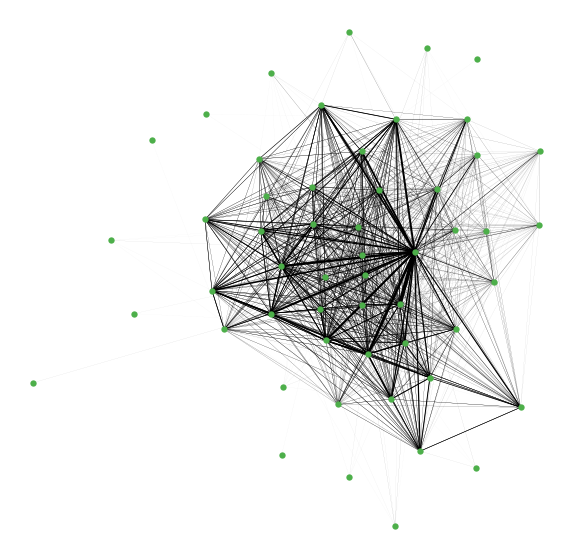

In [310]:
#check information here https://networkx.github.io/documentation/networkx-1.10/reference/drawing.html
# and also the layouts here https://networkx.github.io/documentation/development/_modules/networkx/drawing/layout.html
edgewidth = [ .01 * w['weight'] for (u,v,w) in crime_nx.edges(data=True)]

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111)

nx.draw(crime_nx,
        ax=ax,
        pos=pos,
        node_color="#4daf4a",
        node_size=40,
        font_size=500,
        linewidths=0,
        font_color='b',
        width = edgewidth,
        alpha = 1,
        arrows = False)

# ax.set_ylim([41.75, 41.86])
# ax.set_xlim([-71.48, -71.36])

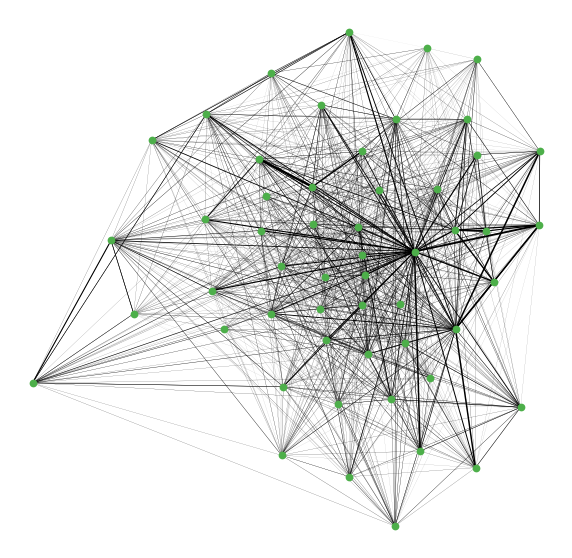

In [311]:
edgewidth = [ .005 * w['weight'] for (u,v,w) in commuting_nx.edges(data=True)]

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111)

nx.draw(commuting_nx,
        ax = ax,
        pos = pos,
        node_color="#4daf4a",
        node_size=60,
        font_size=11,
        linewidths=0,
        font_color='w',
        width = edgewidth,
        alpha = 1,
        arrows = False)

# ax.set_ylim([41.75, 41.86])
# ax.set_xlim([-71.48, -71.36])

In [312]:
print(len(commuting_nx.nodes()))
print(len(commuting_nx.edges()))
print(len(crime_nx.nodes()))
print(len(crime_nx.edges()))

53
1198
53
1479


In [313]:
commuting_nx.in_degree(weight='weight')

InDegreeView({'44007003602': 3465, '44007000800': 7885, '44007003400': 764, '44007013600': 839, '44007000600': 4690, '44007002300': 1704, '44007003500': 1070, '44007014100': 869, '44007003601': 1685, '44007002500': 1684, '44007012500': 880, '44007001200': 835, '44007000300': 1410, '44007000700': 518, '44007003300': 1033, '44007003700': 830, '44007012401': 1549, '44007013500': 415, '44007001900': 894, '44007000200': 1220, '44007002000': 324, '44007012102': 420, '44007001100': 963, '44007002400': 1235, '44007002800': 600, '44007002600': 450, '44007001800': 610, '44007002900': 1375, '44007011901': 474, '44007001600': 459, '44007012402': 270, '44007000102': 665, '44007012000': 1109, '44007000900': 613, '44007000101': 1258, '44007001700': 230, '44007011800': 663, '44007001500': 618, '44007003200': 430, '44007002700': 368, '44007002200': 639, '44007016400': 552, '44007014000': 614, '44007001000': 214, '44007003100': 1282, '44007013701': 555, '44007016300': 304, '44007000400': 680, '440070014

In [314]:
commuting_nx.out_degree(weight='weight')

OutDegreeView({'44007003602': 2044, '44007000800': 635, '44007003400': 1609, '44007013600': 678, '44007000600': 250, '44007002300': 1329, '44007003500': 1844, '44007014100': 695, '44007003601': 955, '44007002500': 805, '44007012500': 950, '44007001200': 519, '44007000300': 1275, '44007000700': 207, '44007003300': 1175, '44007003700': 1360, '44007012401': 1325, '44007013500': 1324, '44007001900': 989, '44007000200': 1259, '44007002000': 1260, '44007012102': 1065, '44007001100': 760, '44007002400': 1820, '44007002800': 1074, '44007002600': 659, '44007001800': 1340, '44007002900': 1420, '44007011901': 580, '44007001600': 1620, '44007012402': 708, '44007000102': 1197, '44007012000': 1514, '44007000900': 725, '44007000101': 1170, '44007001700': 489, '44007011800': 1535, '44007001500': 653, '44007003200': 1075, '44007002700': 1220, '44007002200': 909, '44007016400': 655, '44007014000': 920, '44007001000': 605, '44007003100': 845, '44007013701': 834, '44007016300': 439, '44007000400': 745, '4

In [315]:
crime_nx.in_degree(weight='weight')

InDegreeView({'44007000101': 562, '44007000102': 696, '44007000200': 748, '44007000300': 1774, '44007000400': 1119, '44007000500': 1196, '44007000600': 912, '44007000700': 1101, '44007000800': 4958, '44007000900': 540, '44007001000': 468, '44007001100': 757, '44007001200': 910, '44007001300': 855, '44007001400': 1882, '44007001500': 283, '44007001600': 1793, '44007001700': 476, '44007001800': 1390, '44007001900': 1823, '44007002000': 839, '44007002101': 251, '44007002102': 1018, '44007002200': 1348, '44007002300': 803, '44007002400': 594, '44007002500': 767, '44007002600': 723, '44007002700': 997, '44007002800': 701, '44007002900': 1399, '44007003100': 704, '44007003200': 179, '44007003300': 377, '44007003601': 209, '44007003602': 433, '44007003700': 257, '44007003500': 167, '44007003400': 73, '44007014100': 5, '44007013500': 1, '44007016400': 1, '44007012000': 1, '44007011800': 1, '44007011901': 0, '44007012102': 0, '44007012401': 0, '44007012402': 0, '44007012500': 0, '44007013600': 

In [336]:
crime_out = list(dict(crime_nx.out_degree(weight='weight')).values());
crime_in = list(dict(crime_nx.in_degree(weight='weight')).values());

In [337]:
max(crime_out)

2145

In [342]:
min(crime_in)

0

In [338]:
comm_out = list(dict(commuting_nx.out_degree(weight='weight')).values())
comm_in = list(dict(commuting_nx.in_degree(weight='weight')).values())

In [339]:
max(comm_out)


2044

In [340]:
min(comm_in)

204

In [343]:
ClogBins = np.logspace(np.log10(10), np.log10(4000),num=n_bins)

In [389]:
ClogBinDensity, out_binedges = np.histogram(crime_in, bins=ClogBins,density=True)

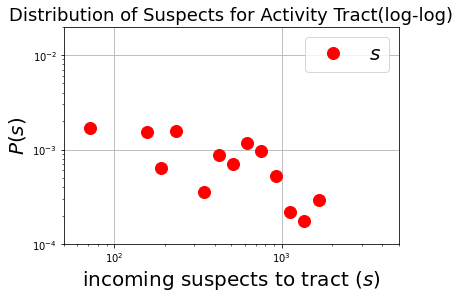

In [438]:
import numpy as np

#linear option not used here
#n, bins = np.histogram(crime_in, bins = range(10,5000, 2)) 
#plt.plot(bins[:-1], n)

n_bins = 30
#option to generate fewer points they are separated in power 
#of 10 and not in linear scale
ClogBins = np.logspace(np.log10(10), np.log10(3000),num=n_bins)
ClogBinDensity, out_binedges = np.histogram(crime_in, bins=ClogBins,density=True)

#plot
plt.figure(1)
# #plt.figure(figsize=(18,8))
plt.loglog(ClogBins[:-1],ClogBinDensity,'o', markersize=12,label=r'$s$',color='r')
#rects2 =plt.bar(out_logBins[:-1],out_logBinDensity)
plt.legend(fontsize=20)

plt.title("Distribution of Suspects for Activity Tract(log-log)",fontsize=18)
plt.xlabel('incoming suspects to tract $(s)$',fontsize=20)
plt.ylabel('$P(s)$',fontsize=20) 
# plt.minorticks_off()
plt.savefig("dist_in_degree.png",dpi=200,bbox_inches='tight')
plt.xlim(50,5000)  ## Select your limits
plt.ylim(0.0001, 0.02)
plt.grid(True)
plt.savefig("dist_in_cime.png",dpi=200,bbox_inches='tight')

In [391]:
#The goal is to look and understand what you plot. 
#We can eliminate the zeros when 
#plotting in lin, they do not appear in the loglog plot
ClogBinDensity

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.0016938 , 0.        , 0.        , 0.        , 0.00154249,
       0.00063354, 0.00156126, 0.        , 0.00035117, 0.00086541,
       0.00071089, 0.00116793, 0.0009594 , 0.0005254 , 0.00021579,
       0.00017727, 0.00029123, 0.        , 0.        ])

## Incoming Commuters

In [392]:
commuting_in = list(dict(commuting_nx.in_degree(weight='weight')).values())

In [393]:
max(commuting_in)

7885

In [394]:
min(commuting_in)

204

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


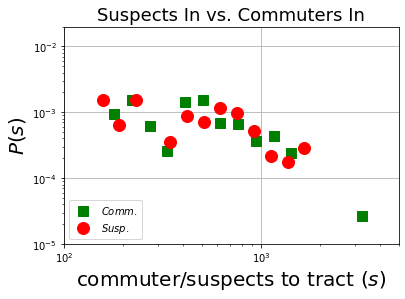

In [440]:
import numpy as np

#linear option not used here
#n, bins = np.histogram(commuting_in, bins = range(200,9000, 2)) 
#plt.plot(bins[:-1], n)

n_bins = 30
out_logBins = np.logspace(np.log10(10), np.log10(4000),num=n_bins)
out_logBinDensity, out_binedges = np.histogram(commuting_in, bins=out_logBins,density=True)

#plot
plt.figure(1)
# #plt.figure(figsize=(18,8))
plt.loglog(out_logBins[:-1],out_logBinDensity,'s', markersize=10,label=r'$Comm.$',color='g')
plt.loglog(ClogBins[:-1],ClogBinDensity,'o', markersize=12,label=r'$Susp.$',color='r')


plt.title("Suspects In vs. Commuters In",fontsize=18)
plt.xlabel('commuter/suspects to tract $(s)$',fontsize=20)
plt.ylabel('$P(s)$',fontsize=20) 
# plt.minorticks_off()
plt.savefig("dist_in_degree.png",dpi=200,bbox_inches='tight')
plt.xlim(100,5000)
plt.ylim(0.00001, 0.02)
plt.grid(True)
plt.legend(fontsize=36)
plt.legend(loc='lower left')
plt.savefig("dist_in_comm.eps",format='eps', dpi=1000)

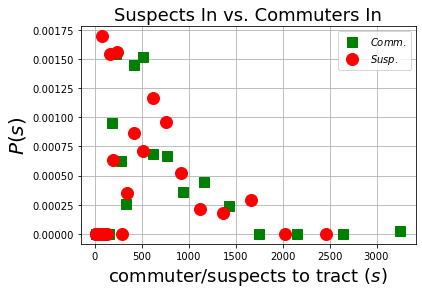

In [441]:
#Linear Scale
n_bins = 30
out_logBins = np.logspace(np.log10(10), np.log10(4000),num=n_bins)
out_logBinDensity, out_binedges = np.histogram(commuting_in, bins=out_logBins,density=True)

plt.plot(out_logBins[:-1],out_logBinDensity,'s', markersize=10,label=r'$Comm.$',color='g')
plt.plot(ClogBins[:-1],ClogBinDensity,'o', markersize=12,label=r'$Susp.$',color='r')
plt.title("Suspects In vs. Commuters In",fontsize=18)
plt.xlabel('commuter/suspects to tract $(s)$',fontsize=18)
plt.ylabel('$P(s)$',fontsize=20) 
# plt.minorticks_off()
plt.savefig("dist_in_degree.png",dpi=200,bbox_inches='tight')
#plt.xlim(100,5000)
#plt.ylim(0.00001, 0.02)
plt.grid(True)
plt.legend(fontsize=36)
plt.legend(loc='upper right')

## Edges properties

In [407]:
wij = []
Cwij = []
g = nx.Graph();
i=0;
for edge in commuting_nx.edges(data=True):
    i=i+1;
    if crime_nx.has_edge(edge[0], edge[1]):
        wij.append(edge[2]['weight'])
        Cwij.append(crime_nx.get_edge_data(edge[0], edge[1])['weight'])    

In [408]:
len(Cwij)

709

In [409]:
len(wij)

709

In [442]:
n_bins = 1050
wij_logBins = np.logspace(np.log10(min(wij)), np.log10(max(wij)),num=n_bins)
#kk_bins = range(70,8000, 2)
counts, bins = np.histogram(wij, bins=wij_logBins); #Averaging the weight in bins
sums, bins = np.histogram(wij, bins=wij_logBins,weights=Cwij); #Averaging theC rime  weight in bins
avg_Cw = sums/counts;

/Users/marta/opt/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in true_divide
  


In [443]:
len(wij_logBins)

1050

In [444]:
np.mean(wij)

52.92242595204513

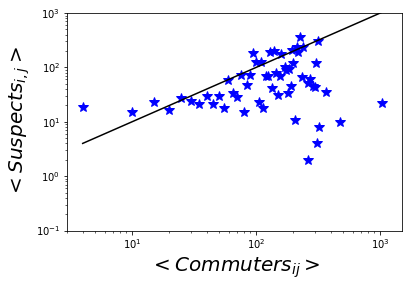

In [445]:
plt.loglog(bins[:-1],avg_Cw,'*',color='b',markersize=10)
#plt.loglog(out_logBins[:-1],out_logBinDensity,'-o', markersize=8,label=r'$s$',color='b')
plt.xlabel('$<Commuters_{ij}>$',fontsize=20)
plt.ylabel('$<Suspects_{i,j}>$',fontsize=20)
plt.minorticks_off()
plt.loglog(bins[:-1],bins[:-1],'k-')
plt.ylim(0.1,1000)
plt.xlim(3,1500)
plt.savefig("commutes.eps",format='eps', dpi=1000)

<Figure size 432x288 with 0 Axes>

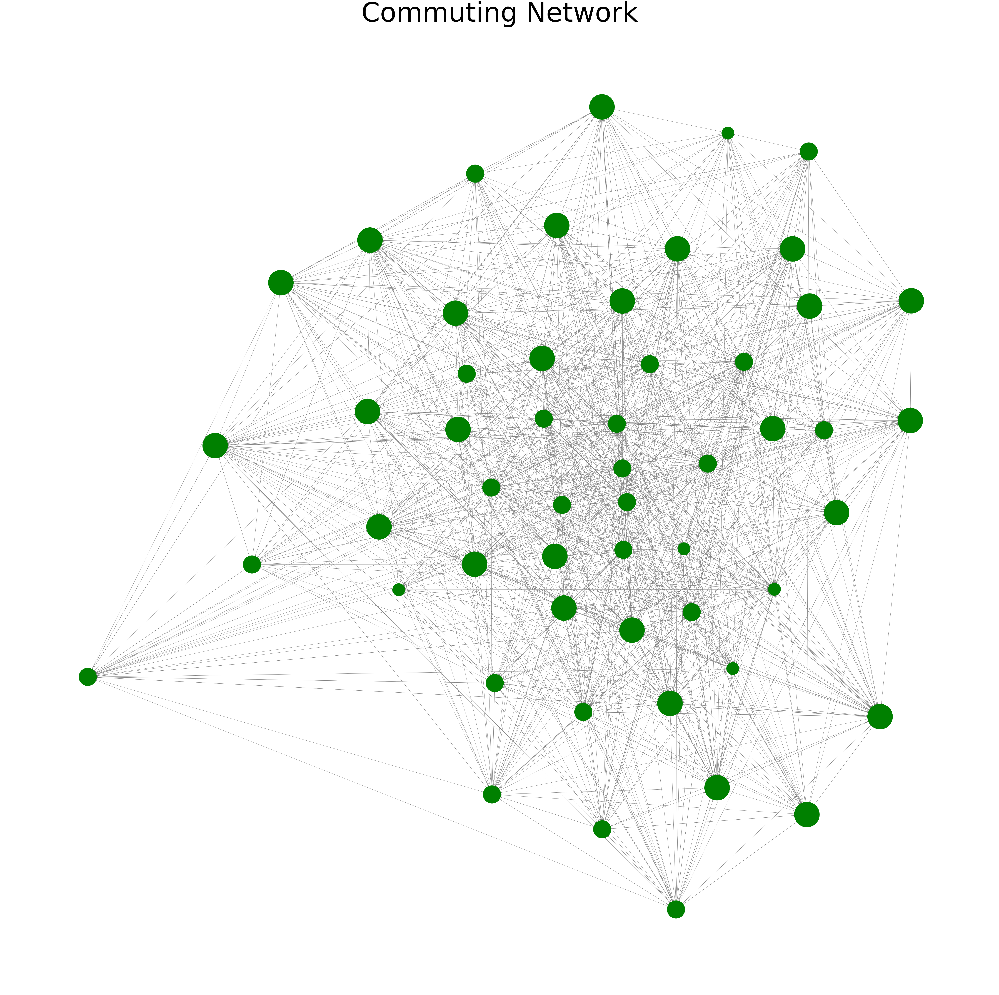

In [428]:
import matplotlib.colors as colors
plt.figure(3)
nsc=[]
ncc=[]
comm_out = dict(commuting_nx.out_degree(weight='weight')).values()

for co in comm_out:
   #print co 
   if(co>=1000):
      nsc.append(20000)
      ncc.append("green")
   if(co>=500 and co<1000):
      nsc.append(10000)
      ncc.append("green")  
   if(co<500):
      nsc.append(5000)  
      ncc.append("green")  
    
plt.figure(figsize=(100,100))         

nx.draw_networkx(commuting_nx, pos, node_size=nsc, node_color = ncc,edge_color='gray',with_labels=False)
plt.title('Commuting Network',fontsize=150)
plt.axis('off')
plt.savefig("Commuting.eps",format='eps', dpi=1000)
#plt.show() # or display

## Visualizing by Edge property by Crime vs. Suspects Relation

We will use three types of edges depending on the relation <Commuters> vs. <Suspects> 

<Figure size 432x288 with 0 Axes>

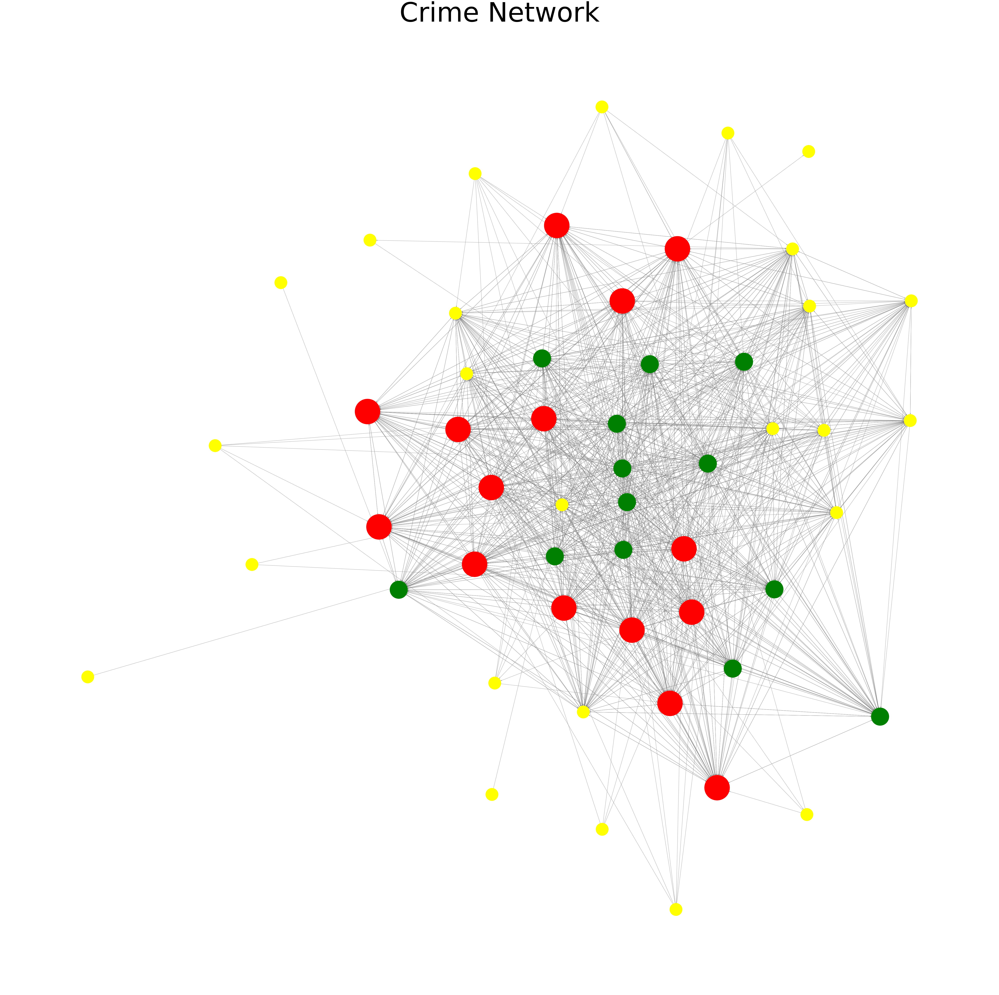

In [429]:
import matplotlib.colors as colors
plt.figure(3)


ns=[]
nc=[]
crime_out = dict(crime_nx.out_degree(weight='weight')).values()
#Create list of colors by degree 
for co in crime_out:
   #print co 
   if(co>=1000):
      ns.append(20000)
      nc.append("red")
   if(co>=500 and co<1000):
      ns.append(10000)
      nc.append("green")  
   if(co<500):
      ns.append(5000)  
      nc.append("yellow")  
#Create list of edeges by color
plt.figure(figsize=(100,100))
eI = [] # commuters>= 100 && suspects <=100 
eII = [] # commuters> 100 && suspects >= commuters 
eIII = [] # commuters<100 && suspects>commuters
eIV= []  # commuters<100 && suspects<=commuters
for u,v in crime_nx.edges():
    sij=crime_nx.get_edge_data(u,v)['weight']
    if commuting_nx.has_edge(u,v):
       cij=commuting_nx.get_edge_data(u,v)['weight']
       if (cij>=100 and sij<100):   
          eI.append((u,v)) 
       if (cij>100 and sij>=cij):   
          eII.append((u,v))
       if (cij<100 and sij>cij):   
          eIII.append((u,v))
       if (cij<100 and sij<=cij):   
          eIV.append((u,v))     
            

nx.draw_networkx(crime_nx, pos, node_size=ns, 
                 node_color = nc,edge_color='gray',with_labels=False)
plt.title('Crime Network',fontsize=150)
plt.axis('off')
plt.savefig("CrimeNetwork.eps",format='eps', dpi=1000)
#plt.show() # or display

(-71.51063673483586, -71.3728322336259, 41.7582411426665, 41.87943161203349)

<Figure size 432x288 with 0 Axes>

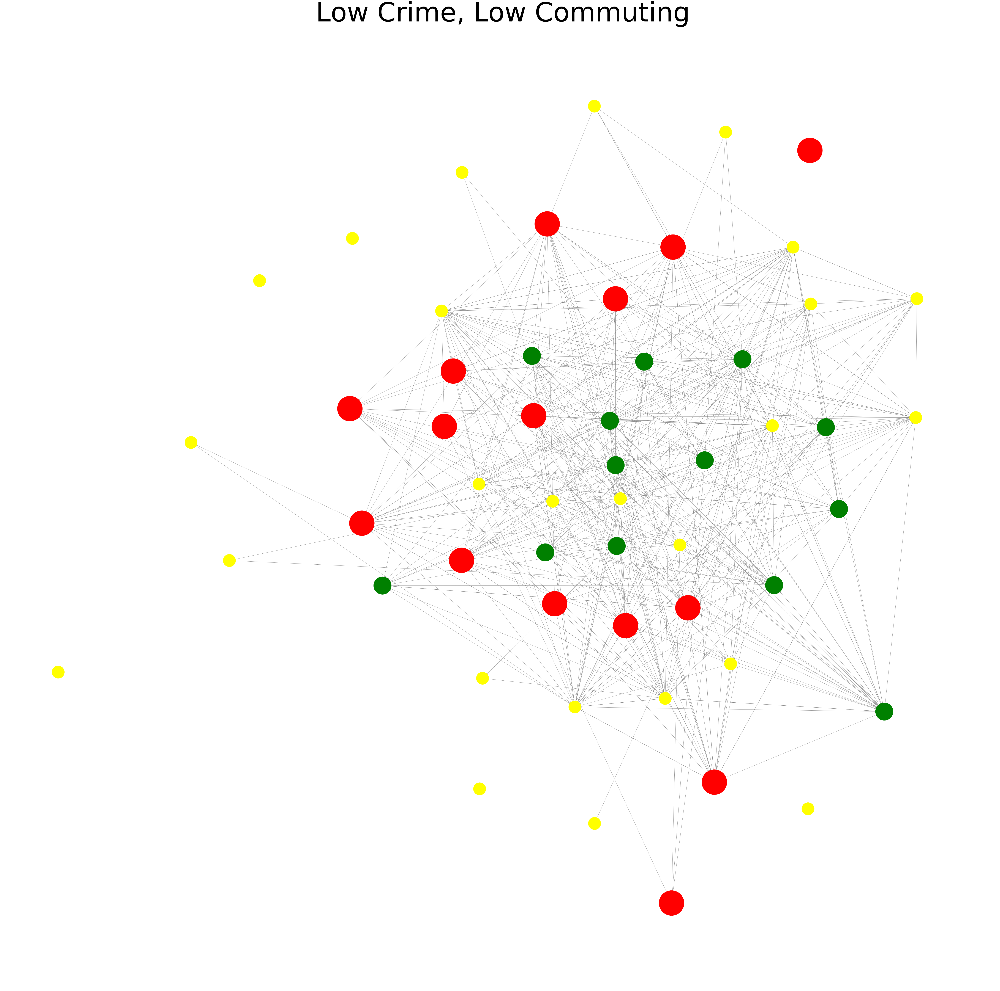

In [90]:
#here we show the original edgelist
plt.figure(4)
plt.figure(figsize=(100,100))
nx.draw_networkx_edges(crime_nx, pos, edgelist = eIV, width = 1 , alpha = 0.9, edge_color='gray')
nx.draw_networkx_nodes(crime_nx, pos,node_size=ns,node_color=nc,linewidth=3)
plt.title('Low Crime, Low Commuting',fontsize=150)
plt.savefig("lowcrime_lowcomm.eps",format='eps', dpi=1000)
plt.axis('off')                     

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

(-71.50982389637049, -71.3728709402195, 41.7635244125865, 41.87865609768349)

<Figure size 432x288 with 0 Axes>

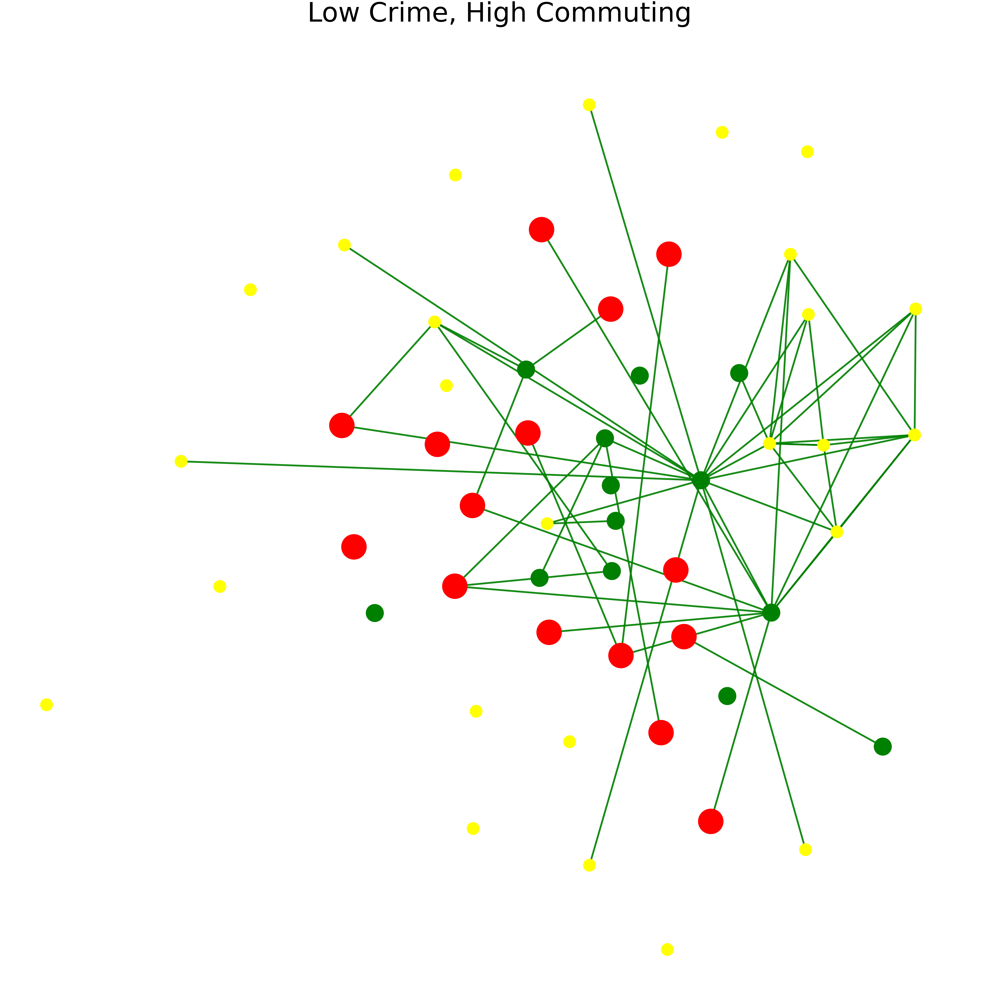

In [433]:
#here we show the edgelist I
plt.figure(5)
plt.figure(figsize=(100,100))
nx.draw_networkx_edges(crime_nx, pos, edgelist = eI, width = 10 , alpha = 0.9, edge_color='green')
nx.draw_networkx_nodes(crime_nx, pos, node_size=ns, node_color = nc, linewidth = 3)
plt.title('Low Crime, High Commuting',fontsize=150)
plt.savefig("lowcrime_highcomm.eps",format='eps', dpi=1000)
plt.axis('off')
         

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

(-71.50957146183, -71.37817206557001, 41.763749800365, 41.873922954334994)

<Figure size 432x288 with 0 Axes>

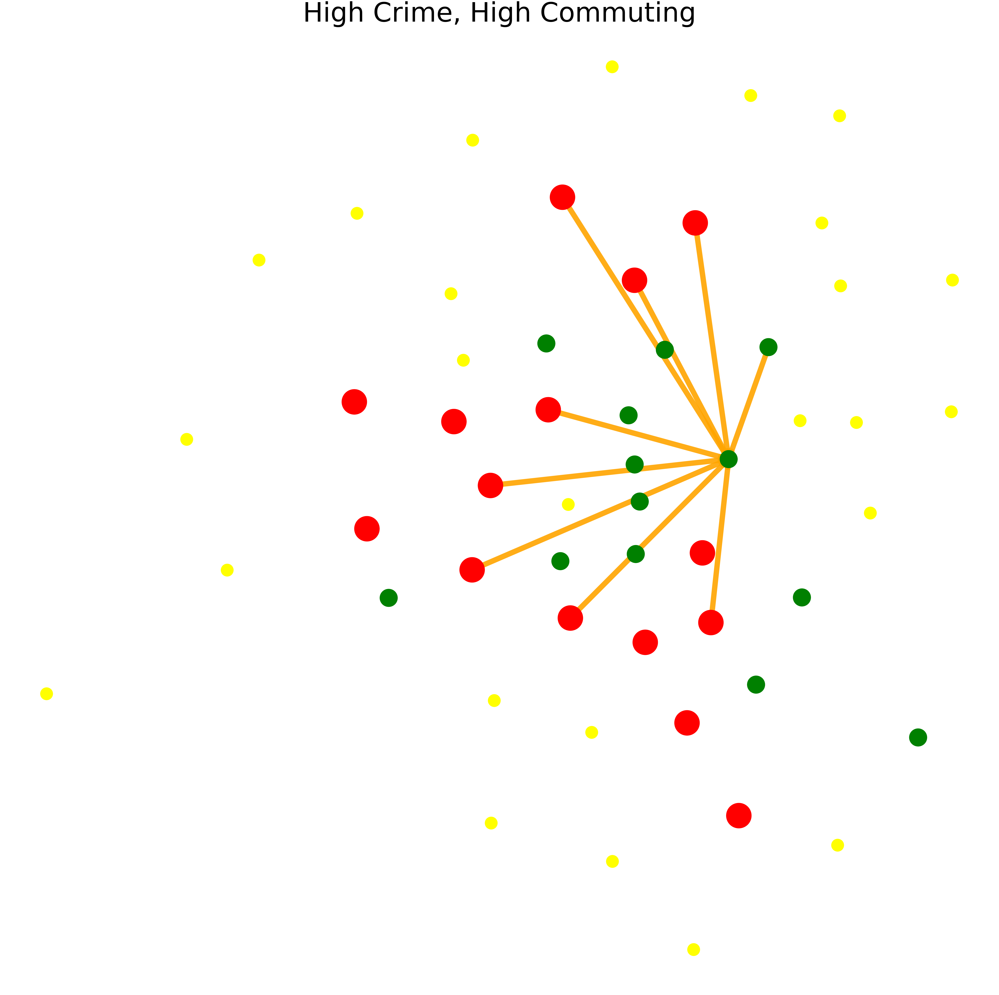

In [434]:
#here we show the edgelist II, note we can save the files
plt.figure(6)
plt.figure(figsize=(100,100))
nx.draw_networkx_edges(crime_nx, pos, edgelist = eII, width = 30 , alpha = 0.9, edge_color='orange')
nx.draw_networkx_nodes(crime_nx, pos, node_size=ns, node_color = nc, linewidth = 3)
plt.title('High Crime, High Commuting',fontsize=150)
plt.savefig("highcrime_highcomm.eps",format='eps', dpi=1000)
plt.axis('off')       

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

(-71.50957146182999, -71.37817206557, 41.763749800365, 41.873922954334994)

<Figure size 432x288 with 0 Axes>

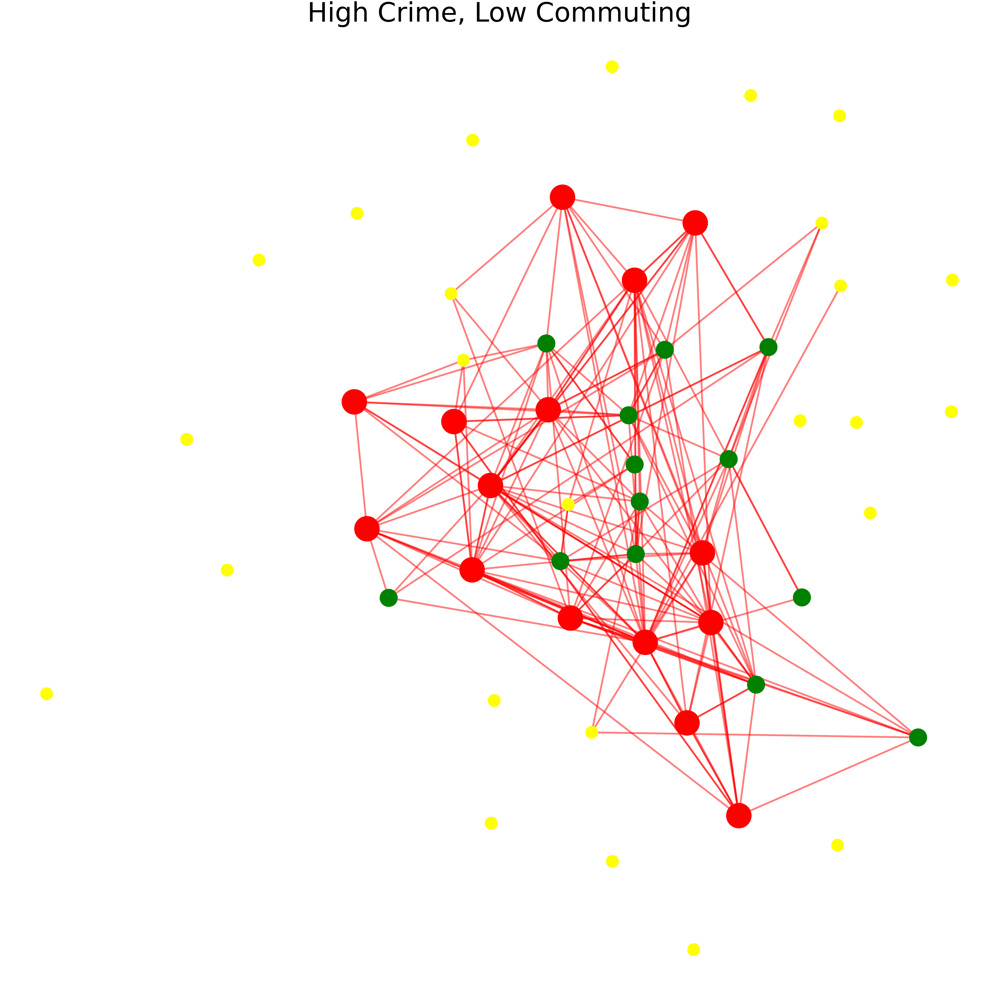

In [435]:
#here we show the edgelist II, note we can save the files
plt.figure(7)
plt.figure(figsize=(100,100))
nx.draw_networkx_edges(crime_nx, pos, edgelist = eIII, width = 10 , alpha = 0.5, edge_color = 'red') # and others
nx.draw_networkx_nodes(crime_nx, pos, node_size=ns, node_color = nc, linewidth = 3)
plt.title('High Crime, Low Commuting',fontsize=150)  
plt.savefig("highcrime_lowcomm.eps",format='eps', dpi=1000)
plt.axis('off')         